In [1]:
%load_ext autoreload
%autoreload 2

/g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore


In [3]:
import sys
import os
import re
from matplotlib import pyplot as plt
from pprint import pprint
from intake import open_esm_datastore
import pandas as pd
import cftime
from datetime import datetime
from dateutil.relativedelta import relativedelta
tool_dir = '/g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore'
sys.path.append(tool_dir)
from plot_functions import _expt_fullname, _read_ryaml, plot_time_series, plot2d, read_ocean_stats, output_dates, truncation_date


In [4]:
cd /g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore
current_folder = !pwd
print(current_folder[0])
pics_folder = "send_to_gfdl"
pics_folder = os.path.join(current_folder[0], pics_folder)
os.makedirs(pics_folder, exist_ok=True)


/g/data/tm70/ml0072/COMMON/git_repos/fork_access-eval-recipes/ml_create_own_datastore


In [5]:
yaml_input = '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/Expts_manager_025deg_restart014_truncate1.yaml'
yamlfile_path = os.path.join(tool_dir,yaml_input)
yaml_input = _read_ryaml(yamlfile_path)
MOM_contrl_dir = yaml_input['base_dir_name']
contrl_name = 'DT_THERM_1350_DIABATIC_FIRST_True'

MOM_expt_dir1 = yaml_input['namelists']['MOM_input']['MOM_input_dirs_restart014']
MOM_list1_combo = yaml_input['namelists']['MOM_input']['MOM_list1_combo']
expt_names = _expt_fullname(MOM_list1_combo)

yaml_input = '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/Expts_manager_025deg_restart022_control.yaml'
yamlfile_path = os.path.join(tool_dir,yaml_input)
yaml_input = _read_ryaml(yamlfile_path)

MOM_expt_dir2 = yaml_input['namelists']['MOM_input']['MOM_input_dirs_restart022']
MOM_list2_combo = yaml_input['namelists']['MOM_input']['MOM_list1_combo']
expt_names2 = _expt_fullname(MOM_list2_combo)

yaml_input = '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/Expts_manager_025deg_restart_rest.yaml'
yamlfile_path = os.path.join(tool_dir,yaml_input)
yaml_input = _read_ryaml(yamlfile_path)

MOM_expt_dir3 = yaml_input['namelists']['MOM_input']['MOM_input_dirs_restart_rest']
MOM_list3_combo = yaml_input['namelists']['MOM_input']['MOM_list1_combo']
expt_names3 = _expt_fullname(MOM_list3_combo)

MOM_dirs = [MOM_contrl_dir]+list(MOM_expt_dir1) +list(MOM_expt_dir2)+list(MOM_expt_dir3)
MOM_names = [contrl_name] + list(expt_names) + list(expt_names2)+ list(expt_names3)

In [6]:
output_expt_path = '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg'
intake_esm_ds = 'intake_esm_ds.json'

In [7]:
datastore_tot = []
MOM_dirs_tot = []
MOM_names_tot = []
for i,j in zip(MOM_dirs,MOM_names):
    archive_path = os.path.join(f"{output_expt_path}",f"{i}","archive")
    datastore_path = os.path.join(f"{archive_path}",intake_esm_ds)
    if os.path.isfile(datastore_path):
        datastore = open_esm_datastore(datastore_path,columns_with_iterables=["variable"])
        datastore_tot.append(datastore)
        MOM_dirs_tot.append(f"{i}")
        MOM_names_tot.append(f"{j}")
pprint(MOM_dirs_tot)
pprint(MOM_names_tot)
pprint(datastore_tot)

['Ctrl-025deg_jra55do_ryf',
 'lexpt1_r14',
 'lexpt2_r14',
 'lexpt3_r14',
 'lexpt4_r14',
 'lexpt0_r14',
 'lexpt0_r22',
 'lexpt4_rr',
 'lexpt0_rr']
['DT_THERM_1350_DIABATIC_FIRST_True',
 'DT_THERM_2700_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_2700_MAXTRUNC_0',
 'DT_THERM_5400_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_5400_MAXTRUNC_20',
 'DT_THERM_6750_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_6750_MAXTRUNC_20',
 'DT_THERM_10800_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_10800_MAXTRUNC_100',
 'DT_THERM_1350_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_False_DTBT_RESET_PERIOD_1350_MAXTRUNC_0',
 'DT_THERM_1350_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_False_DTBT_RESET_PERIOD_1350_MAXTRUNC_0',
 'DT_THERM_10800_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_True_DTBT_RESET_PERIOD_10800_MAXTRUNC_100',
 'DT_THERM_1350_DIABATIC_FIRST_False_THERMO_SPANS_COUPLING_False_DTBT_RESET_PERIOD_1350_MAXTRUNC_1000']


In [8]:
MOM_names_tot = [
    'DT_THERM_1350_DIABATIC_FIRST_True',
    'DT_THERM_2700_DIABATIC_FIRST_False_r14',
    'DT_THERM_5400_DIABATIC_FIRST_False_r14',
    'DT_THERM_6750_DIABATIC_FIRST_False_r14',
    'DT_THERM_10800_DIABATIC_FIRST_False_r14',
    'DT_THERM_1350_DIABATIC_FIRST_False_r14',
    'DT_THERM_1350_DIABATIC_FIRST_False_r22',
    'DT_THERM_10800_DIABATIC_FIRST_False_rr',
    'DT_THERM_1350_DIABATIC_FIRST_False_rr',
]

In [20]:
import xarray as xr
import cf_xarray as cfxr
import cf_xarray.units
import pint_xarray
from pint import application_registry as ureg

In [16]:
var='rhopot2'
tmp = datastore_tot[0].search(variable=var)
rho2_dict = tmp.to_dataset_dict(progressbar=True)
rho2_dict['access_om3_mom6_3d_rhopot2_1mon_snap_1900.1mon']


--> The keys in the returned dictionary of datasets are constructed as follows:
	'file_id.frequency'


<xarray.Dataset> Size: 4GB
Dimensions:  (time: 12, zl: 50, yh: 1080, xh: 1440)
Coordinates:
  * xh       (xh) float64 12kB -279.9 -279.6 -279.4 -279.1 ... 79.38 79.62 79.88
  * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
  * zl       (zl) float64 400B 1.152 3.649 6.565 ... 5.034e+03 5.572e+03
  * time     (time) object 96B 1900-02-01 00:00:00 ... 1901-01-01 00:00:00
Data variables:
    rhopot2  (time, zl, yh, xh) float32 4GB dask.array<chunksize=(1, 17, 360, 480), meta=np.ndarray>
Attributes: (12/20)
    NumFilesInSet:                            1
    title:                                    ACCESS-OM3
    associated_files:                         areacello: access-om3.mom6.stat...
    grid_type:                                regular
    grid_tile:                                N/A
    intake_esm_vars:                          ['rhopot2']
    ...                                       ...
    intake_esm_attrs:variable_cell_methods:   ['area:mean zl:mean yh:mean xh:...
    intake_esm_attrs:variable_units:          ['kg m-3']
    intake_esm_attrs:filename:                access-om3.mom6.3d.rhopot2.1mon...
    intake_esm_attrs:file_id:                 access_om3_mom6_3d_rhopot2_1mon...
    intake_esm_attrs:_data_format_:           netcdf
    intake_esm_dataset_key:                   access_om3_mom6_3d_rhopot2_1mon...

In [36]:
var='umo'
tmp = datastore_tot[0].search(variable=var)
#print(type(tmp))
umo_dict = tmp.to_dataset_dict(progressbar=True)
umo_tmp = umo_dict['access_om3_mom6_3d_umo_1mon_snap_1900.1mon'].pint.quantify()
umo_tmp2 = umo_tmp.cf.sum("longitude")


--> The keys in the returned dictionary of datasets are constructed as follows:
	'file_id.frequency'


In [44]:
umo_tmp3 = umo_tmp2.cf.sum("vertical")
umo_tmp3

<xarray.Dataset> Size: 61kB
Dimensions:  (time: 12, yh: 1080)
Coordinates:
  * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
  * time     (time) object 96B 1900-02-01 00:00:00 ... 1901-01-01 00:00:00
Data variables:
    umo      (time, yh) float32 52kB [kg/s] dask.array<sum-aggregate, shape=(...

In [37]:
umo_tmp2

<xarray.Dataset> Size: 3MB
Dimensions:  (time: 12, zl: 50, yh: 1080)
Coordinates:
  * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
  * zl       (zl) float64 400B 1.152 3.649 6.565 ... 5.034e+03 5.572e+03
  * time     (time) object 96B 1900-02-01 00:00:00 ... 1901-01-01 00:00:00
Data variables:
    umo      (time, zl, yh) float32 3MB [kg/s] dask.array<sum-aggregate, shap...

In [32]:
tmp2 = umo_dict['access_om3_mom6_3d_umo_1mon_snap_1900.1mon'].pint.quantify()
tmp2.attrs

{'NumFilesInSet': 1,
 'title': 'ACCESS-OM3',
 'grid_type': 'regular',
 'grid_tile': 'N/A',
 'intake_esm_vars': ['umo'],
 'intake_esm_attrs:path': '/g/data/tm70/ml0072/COMMON/git_repos/COSIMA_om3-scripts/expts_manager/product1_0.25deg/Ctrl-025deg_jra55do_ryf/archive/output000/access-om3.mom6.3d.umo.1mon.snap.1900.nc',
 'intake_esm_attrs:realm': 'ocean',
 'intake_esm_attrs:variable': 'umo',
 'intake_esm_attrs:frequency': '1mon',
 'intake_esm_attrs:start_date': '1900-02-01, 00:00:00',
 'intake_esm_attrs:end_date': '1901-02-01, 00:00:00',
 'intake_esm_attrs:variable_long_name': "['Ocean Mass X Transport']",
 'intake_esm_attrs:variable_standard_name': "['ocean_mass_x_transport']",
 'intake_esm_attrs:variable_cell_methods': "['zl:sum yh:sum xq:point time: point']",
 'intake_esm_attrs:variable_units': "['kg s-1']",
 'intake_esm_attrs:filename': 'access-om3.mom6.3d.umo.1mon.snap.1900.nc',
 'intake_esm_attrs:file_id': 'access_om3_mom6_3d_umo_1mon_snap_1900',
 'intake_esm_attrs:_data_format_': '

In [9]:
dfs_all = {}

for i in MOM_dirs:
    tmp_dfs = []
    archive_path = os.path.join(output_expt_path,i,"archive")
    outputs = [file_name for file_name in os.listdir(archive_path) if file_name.startswith("output")]
    outputs.sort(key=lambda x: int(re.findall(r'\d+', x)[0]))

    for file_name in outputs:
        ocean_stats_path = os.path.join(archive_path, file_name, "ocean.stats")
        df = read_ocean_stats(ocean_stats_path)
        df['old_index'] = df.index
        tmp_dfs.append(df)

    if tmp_dfs:
        dfs = pd.concat(tmp_dfs)
        dfs = dfs.reset_index(drop=True)
        dfs_all[i] = dfs

In [10]:
year_start = [0, 15, 15, 15, 15, 15, 22, 0, 0]
truncs_date_all = []
for i in range(len(year_start)):
    df_tmp = dfs_all[MOM_dirs_tot[i]]
    starting_date = datetime(1900,1,1) + relativedelta(years=year_start[i])
    dt = 1350
    truncs_date = truncation_date(df_tmp, starting_date, dt)
    truncs_date_all.append(truncs_date)

0
1
2
3
4
5
6
7
8


<Figure size 640x480 with 0 Axes>

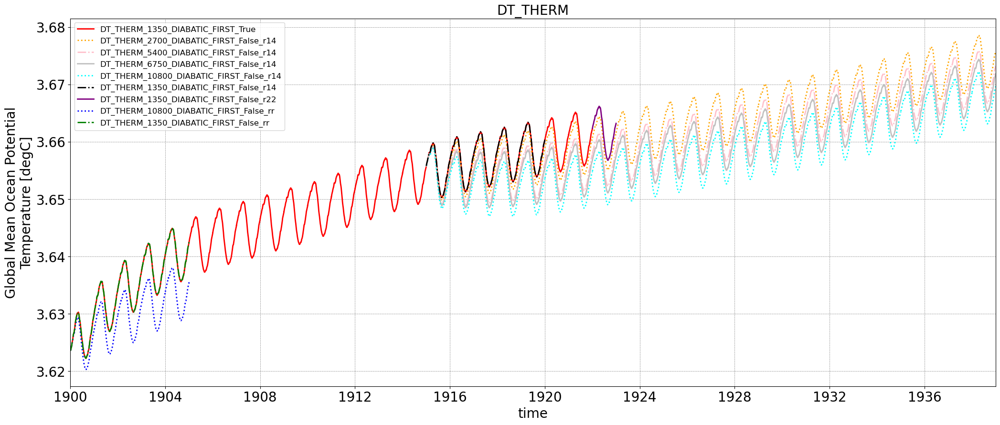

In [32]:
var = 'thetaoga'
line_color = ['red','orange','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, 1, 2,3,4,5,6,7,8], 'title': 'DT_THERM', 'base_index': None},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(25,10),
                        time_range = ['1900-01-01', '1939-01-01'],
                        xlims = ('1900-01-01', '1939-01-01'),
                        #ylims = [3.62, 3.65],
                        num_intervals = None,
                        use_subplots=False,
                        )
# ax = plt.gca()
# for i in plots_config[0]['indices']:
#     truncs_date = truncs_date_all[i]
#     pprint(f"{MOM_names_tot[i]}: {truncs_date}")
#     for data_date in truncs_date:
#         data_value = pd.to_datetime(data_date)
#         ax.plot([data_value, data_value], [3.62, 3.65], color=line_color[i], linewidth=2, linestyle='--')
# plt.tight_layout()
# plt.show()

0
1
2
3
4
5
6
7
8


<Figure size 640x480 with 0 Axes>

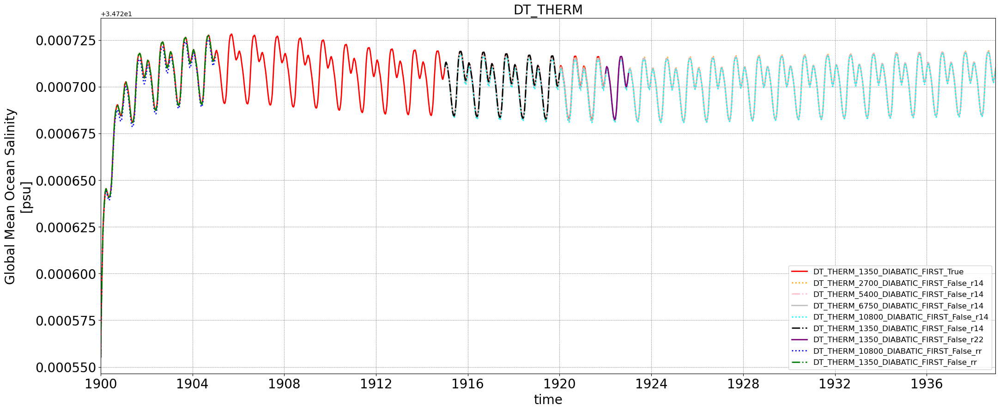

In [34]:
var = 'soga'
line_color = ['red','orange','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, 1, 2,3,4,5,6,7,8], 'title': 'DT_THERM', 'base_index': None},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'lower right',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(25,10),
                        time_range = ['1900-01-01', '1939-01-01'],
                        xlims = ('1900-01-01', '1939-01-01'),
                        #ylims = [3.62, 3.65],
                        num_intervals = None,
                        use_subplots=False,
                        )

0
-1
-2


<Figure size 640x480 with 0 Axes>

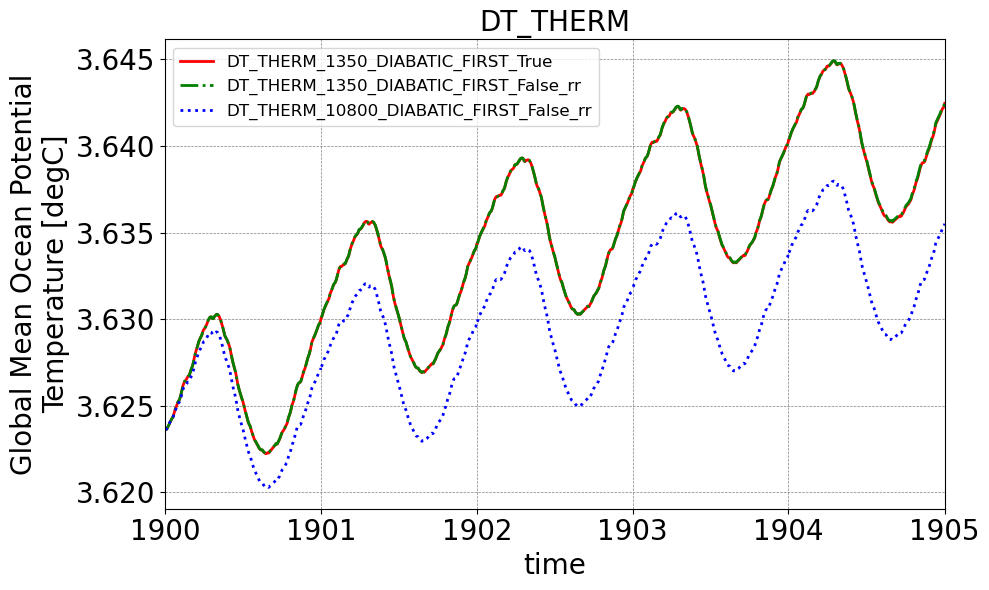

In [101]:
var = 'thetaoga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': None},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        #ylims = [3.62, 3.65],
                        num_intervals = None,
                        use_subplots=False,
                        )
# ax = plt.gca()
# for i in plots_config[0]['indices']:
#     truncs_date = truncs_date_all[i]
#     pprint(f"{MOM_names_tot[i]}: {truncs_date}")
#     for data_date in truncs_date:
#         data_value = pd.to_datetime(data_date)
#         ax.plot([data_value, data_value], [3.62, 3.65], color=line_color[i], linewidth=2, linestyle='--')
plt.tight_layout()
pic_name = "thetaoga_compare"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

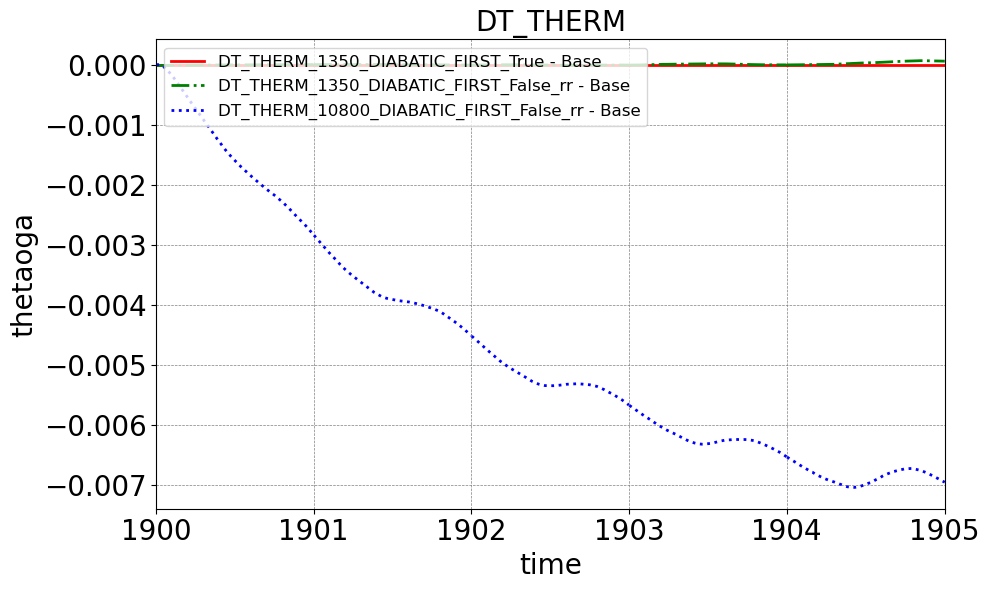

In [103]:
var = 'thetaoga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': 0},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'upper left',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        #ylims = [3.62, 3.65],
                        num_intervals = None,
                        use_subplots=False,
                        )
# ax = plt.gca()
# for i in plots_config[0]['indices']:
#     truncs_date = truncs_date_all[i]
#     print(f"{MOM_names_tot[i]}: {truncs_date}")
#     for data_date in truncs_date:
#         data_value = pd.to_datetime(data_date)
#         ax.plot([data_value, data_value], [-8e-3, 1e-4], color=line_color[i], linewidth=2, linestyle='--')
plt.tight_layout()
pic_name = "thetaoga_compare_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

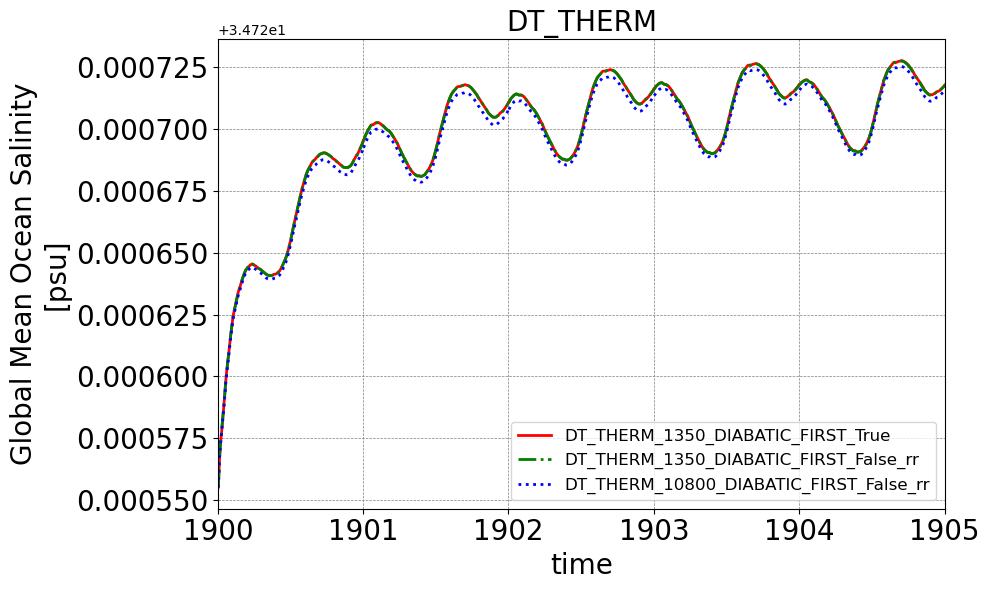

In [11]:
var = 'soga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': None},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'lower right',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        #ylims = [3.62, 3.65],
                        num_intervals = None,
                        use_subplots=False,
                        )
plt.tight_layout()
pic_name = "soga_compare"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
-1
-2


<Figure size 640x480 with 0 Axes>

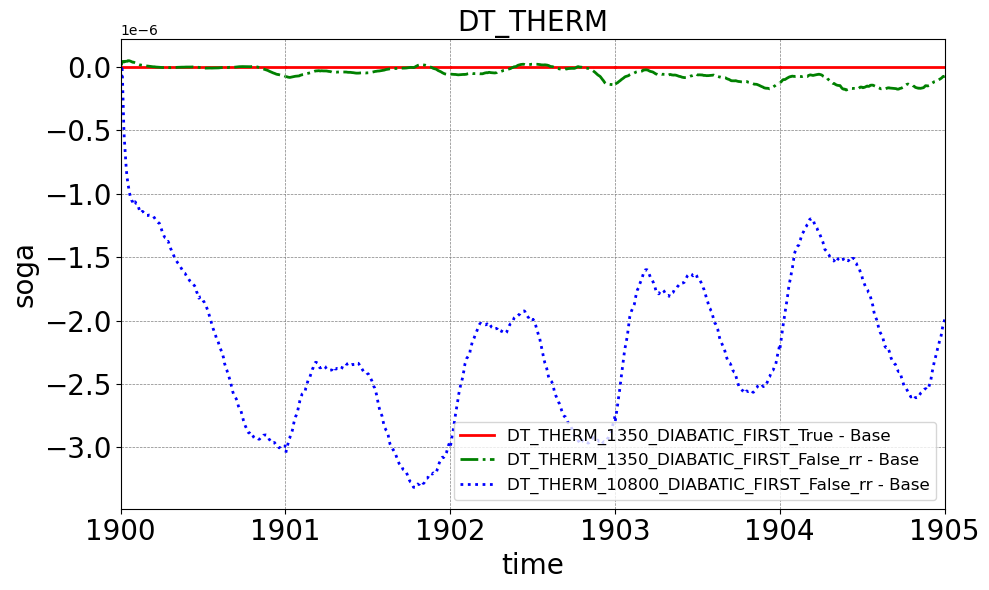

In [13]:
var = 'soga'
line_color = ['red','gold','pink','silver','cyan','black','purple','blue','green']
line_style = ['-',':','-.']
line_marker = ['o','s','v']
line_width = [2,2,2]
plots_config = [
            {'indices': [0, -1, -2], 'title': 'DT_THERM', 'base_index': 0},
           ]
plt.clf()
plot_time_series(datastore_tot,MOM_names_tot,var,
                        line_style=line_style,
                        line_color=line_color,
                        line_marker=line_marker,
                        line_width=line_width,
                        legend_loc = 'best',
                        legend_fontsize = 12,
                        plots_config=plots_config,
                        figsize=(10,6),
                        time_range = ['1900-01-01', '1905-01-01'],
                        xlims = ('1900-01-01', '1905-01-01'),
                        #ylims = [3.62, 3.65],
                        num_intervals = None,
                        use_subplots=False,
                        )
plt.tight_layout()
pic_name = "soga_compare_diff"
file_path = os.path.join(pics_folder, pic_name+ ".png")
plt.savefig(file_path,dpi=300)
plt.show()

0
1
2


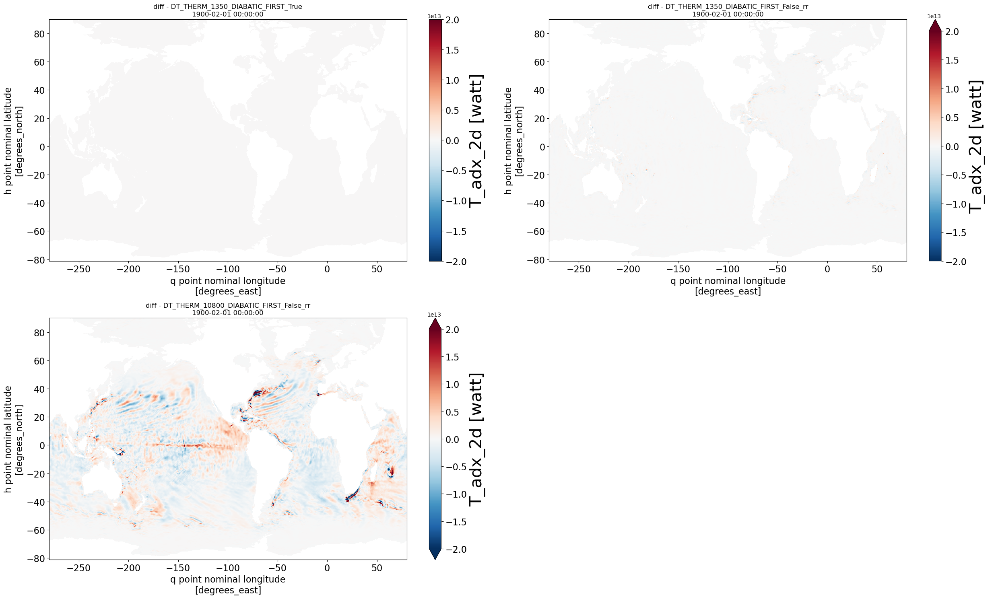

In [28]:
var = 'T_adx_2d'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-2e13,2e13]
      )

0
1
2


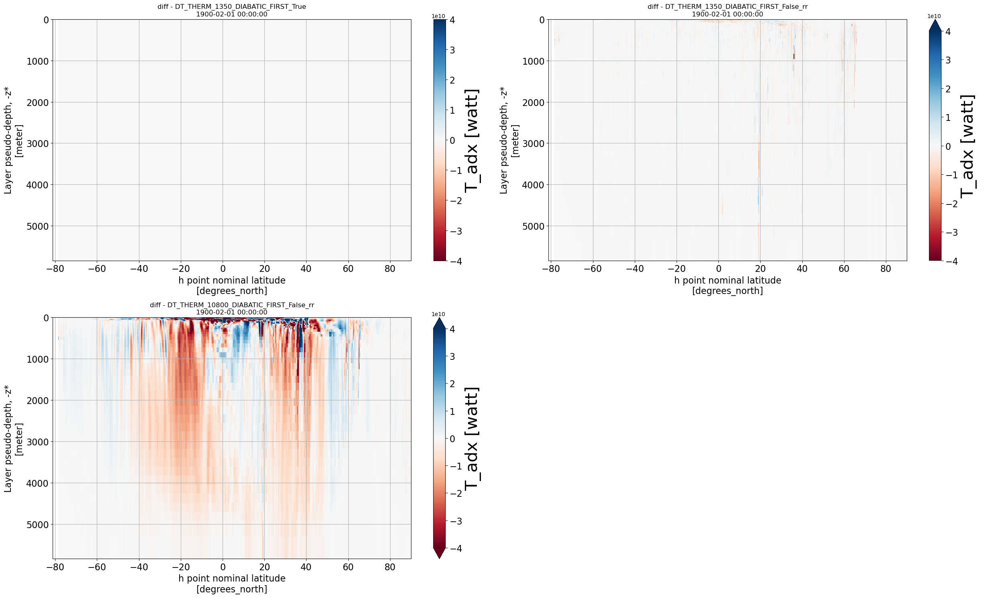

In [75]:
var = 'T_adx'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_sum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        cbar_range=[-4e10, 4e10],
      )

In [ ]:
var = 'uo'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        #datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_sum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        cbar_range=[-0.2, 0.2],
      )

0
1


0
1
2


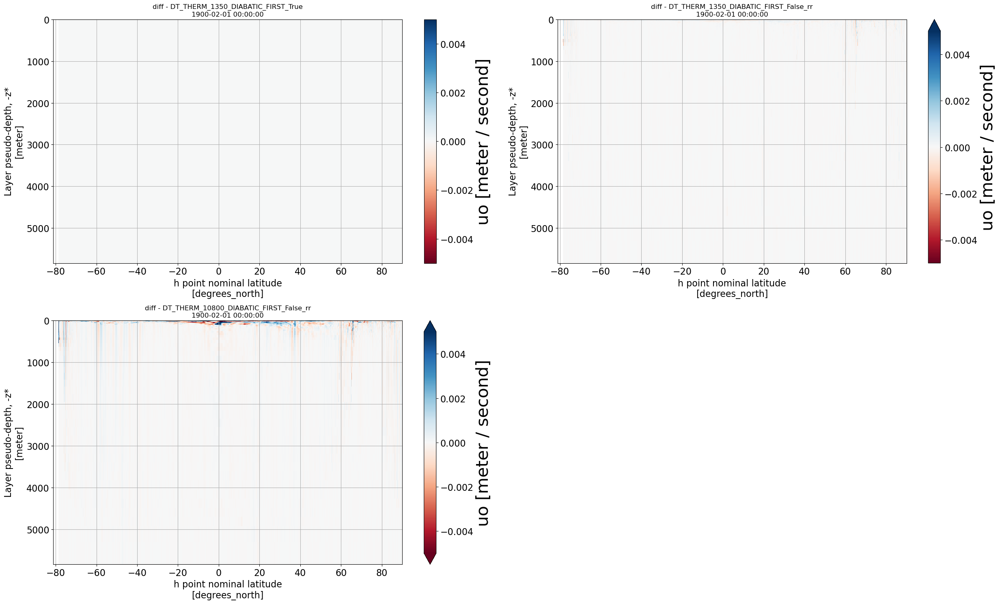

In [78]:
var = 'uo'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_sum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        cbar_range=[-0.005, 0.005],
      )

0
1
2


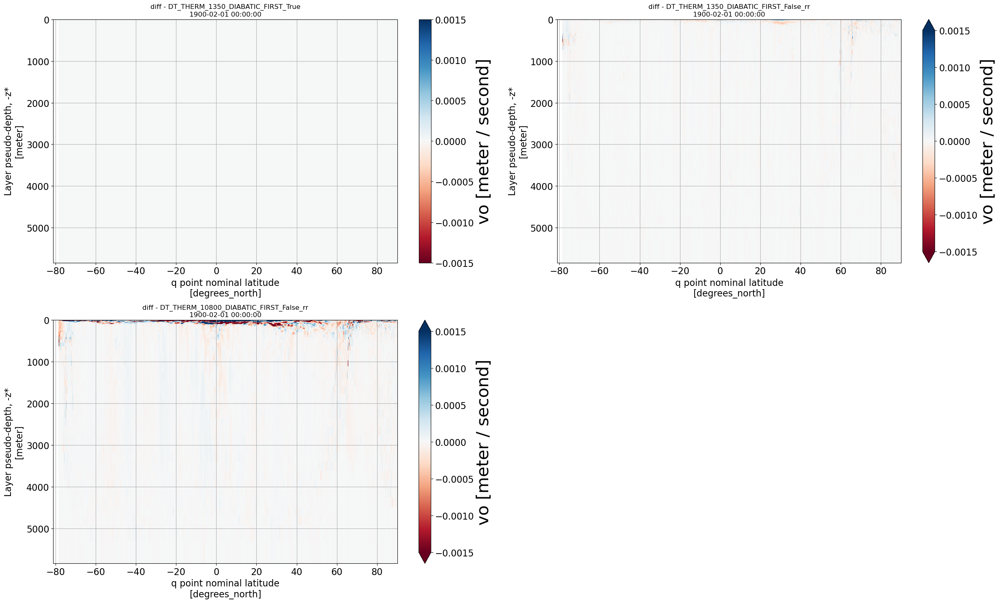

In [81]:
var = 'vo'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cf_sum_lon=False, cf_sum_vertical=False, cf_mean_time=False, cf_mean_lon=True,
        cbar_range=[-0.0015, 0.0015],
      )

0
1
2


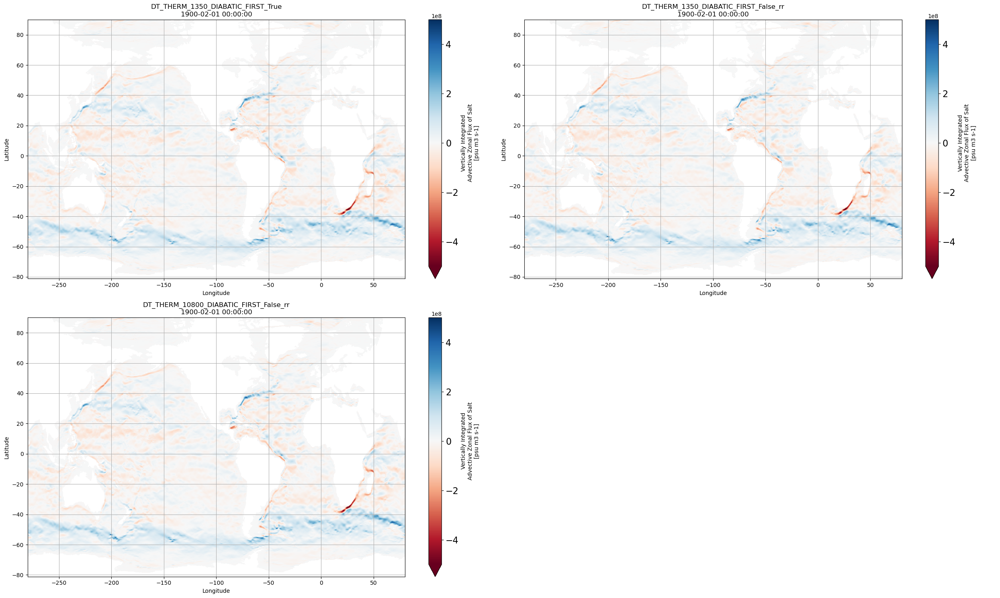

In [15]:
var = 'S_adx_2d'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-5e8,5e8])

0
1
2


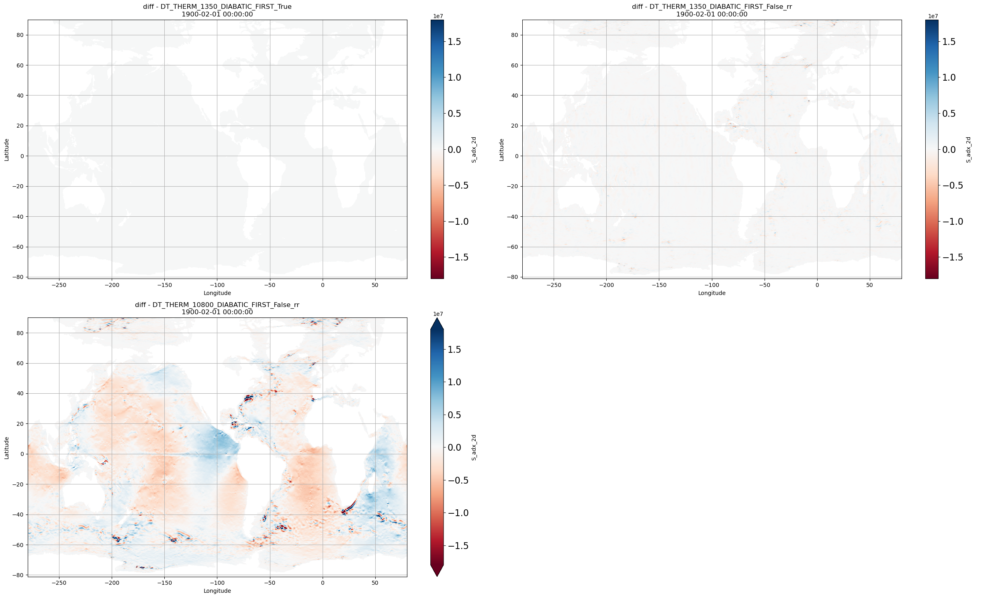

In [16]:
var = 'S_adx_2d'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-1.8e7,1.8e7])

0
1
2


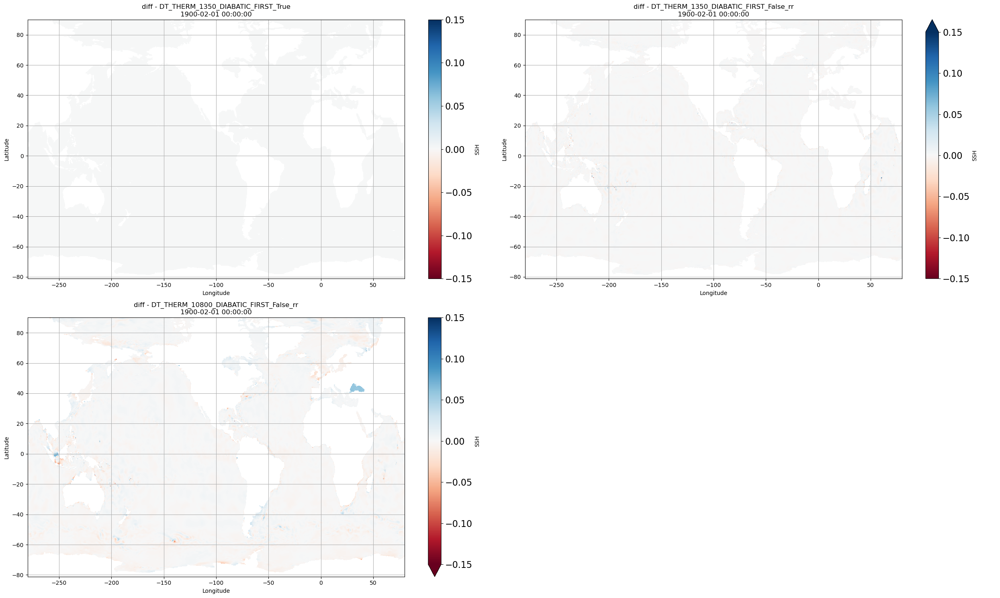

In [37]:
var = 'SSH'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-0.15, 0.15])

0
1
2


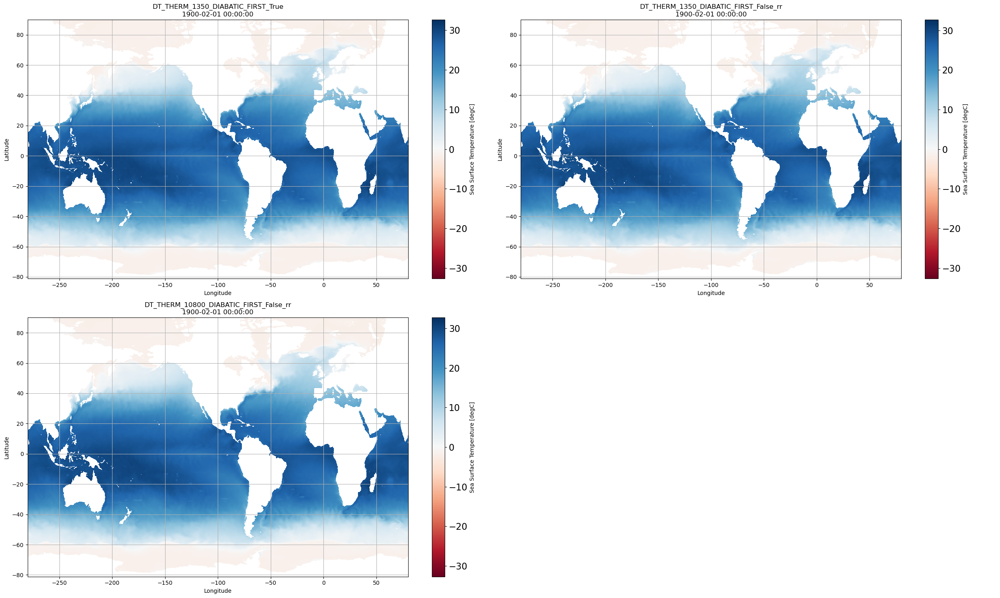

In [45]:
var = 'tos'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15))

0
1
2


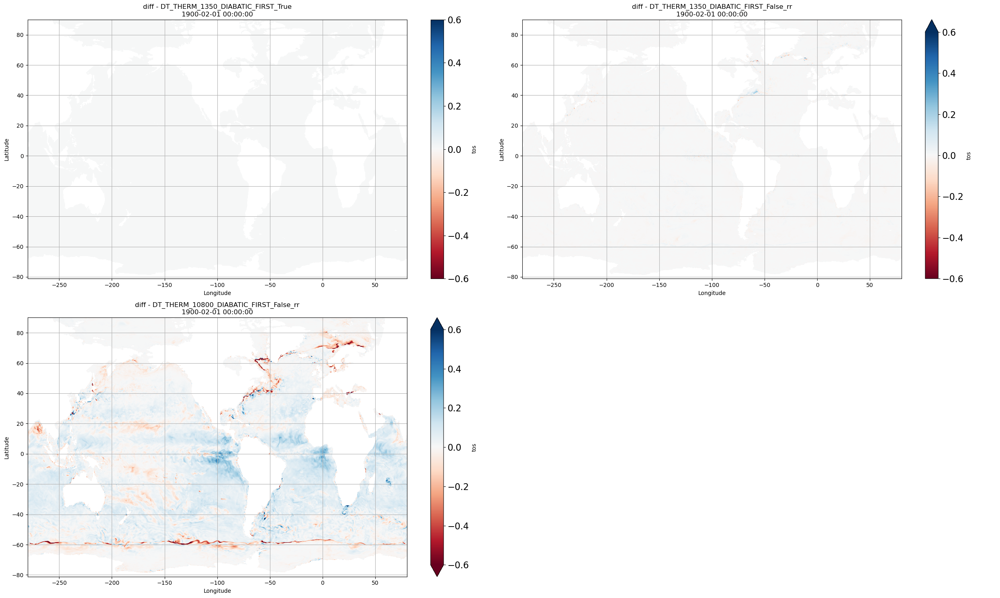

In [47]:
var = 'tos'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-0.6, 0.6])

0
<xarray.DataArray 'SSU' (yh: 1080, xq: 1440)> Size: 6MB
dask.array<sub, shape=(1080, 1440), dtype=float32, chunksize=(1080, 1440), chunktype=numpy.ndarray>
Coordinates:
  * xq       (xq) float64 12kB -279.8 -279.5 -279.2 -279.0 ... 79.5 79.75 80.0
  * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
    time     object 8B 1900-02-01 00:00:00
1
<xarray.DataArray 'SSU' (yh: 1080, xq: 1440)> Size: 6MB
dask.array<sub, shape=(1080, 1440), dtype=float32, chunksize=(1080, 1440), chunktype=numpy.ndarray>
Coordinates:
  * xq       (xq) float64 12kB -279.8 -279.5 -279.2 -279.0 ... 79.5 79.75 80.0
  * yh       (yh) float64 9kB -81.08 -80.97 -80.87 -80.76 ... 89.74 89.84 89.95
    time     object 8B 1900-02-01 00:00:00
2
<xarray.DataArray 'SSU' (yh: 1080, xq: 1440)> Size: 6MB
dask.array<sub, shape=(1080, 1440), dtype=float32, chunksize=(1080, 1440), chunktype=numpy.ndarray>
Coordinates:
  * xq       (xq) float64 12kB -279.8 -279.5 -279.2 -279.0 ... 79.5 79.75 80.0
  * 

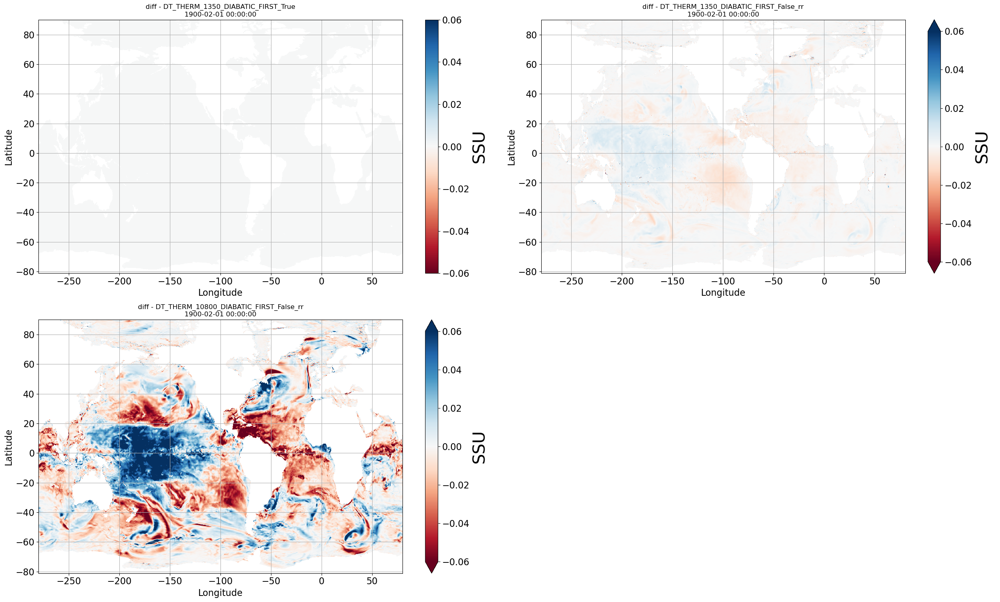

In [97]:
var = 'SSU'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        abs_threshold_value = None,
        # xq_subset=slice(50,80),
        # yh_subset=slice(-40,-10),
        cbar_range=[-0.06, 0.06],
        )

0
1
2


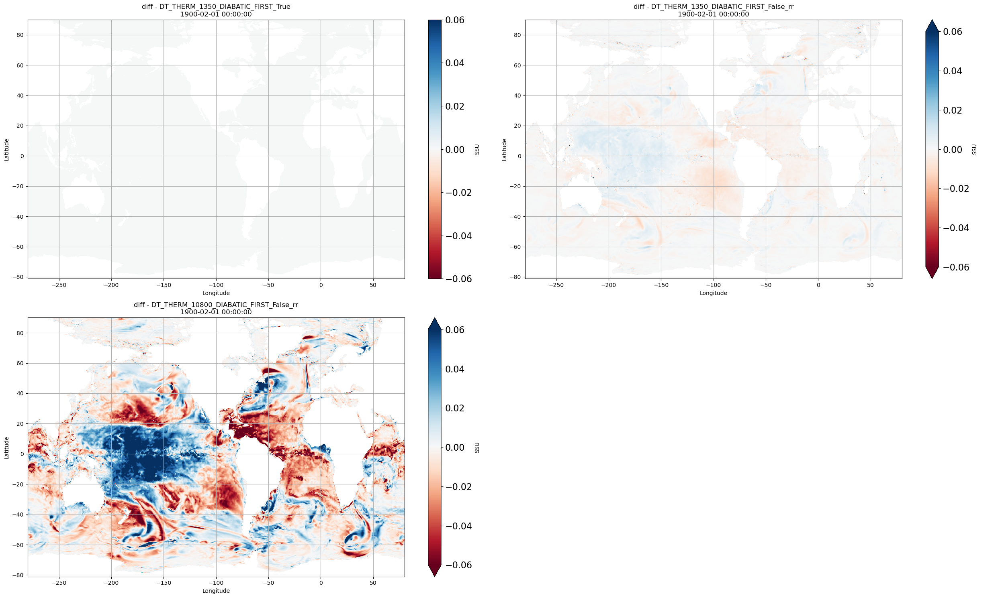

In [40]:
var = 'SSU'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-0.06, 0.06])

0
1
2


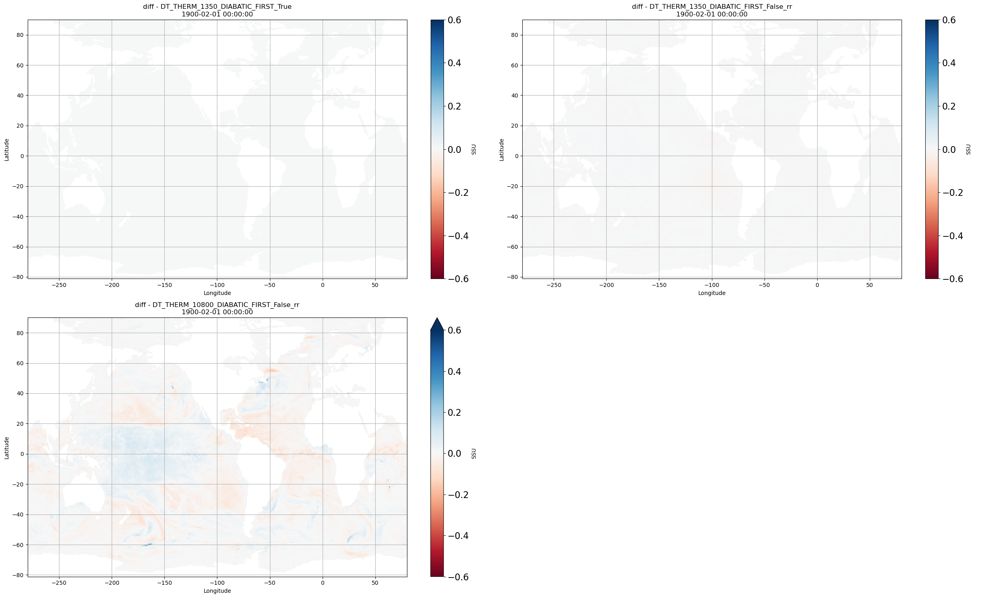

In [41]:
var = 'SSU'
common_time = pd.Timestamp('1900-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,-1,-2]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-0.6, 0.6])

0
1
2
3
4
5


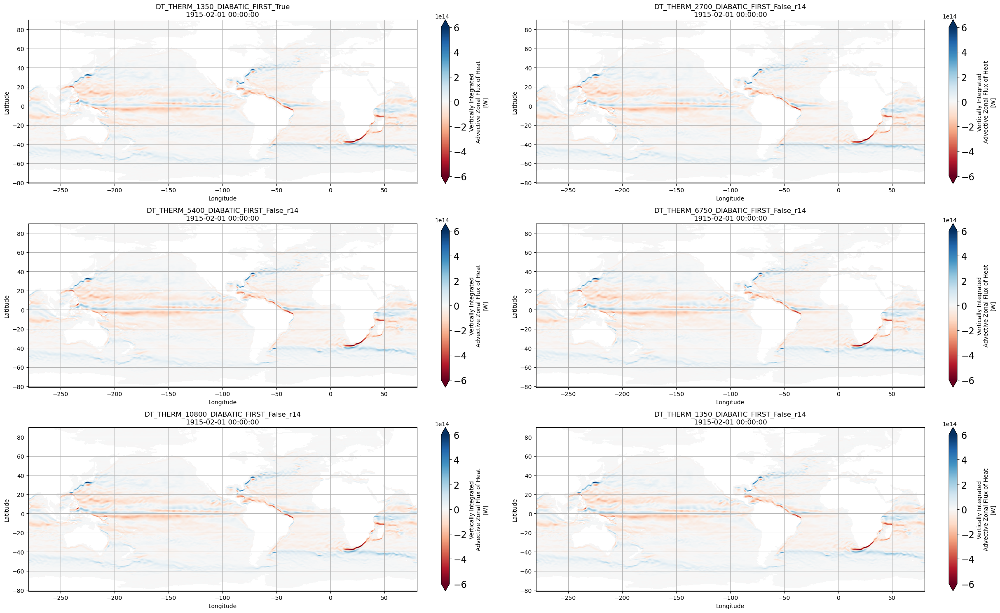

In [18]:
var = 'T_adx_2d'
common_time = pd.Timestamp('1915-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4,5]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-6e14,6e14])

0
1
2
3
4
5


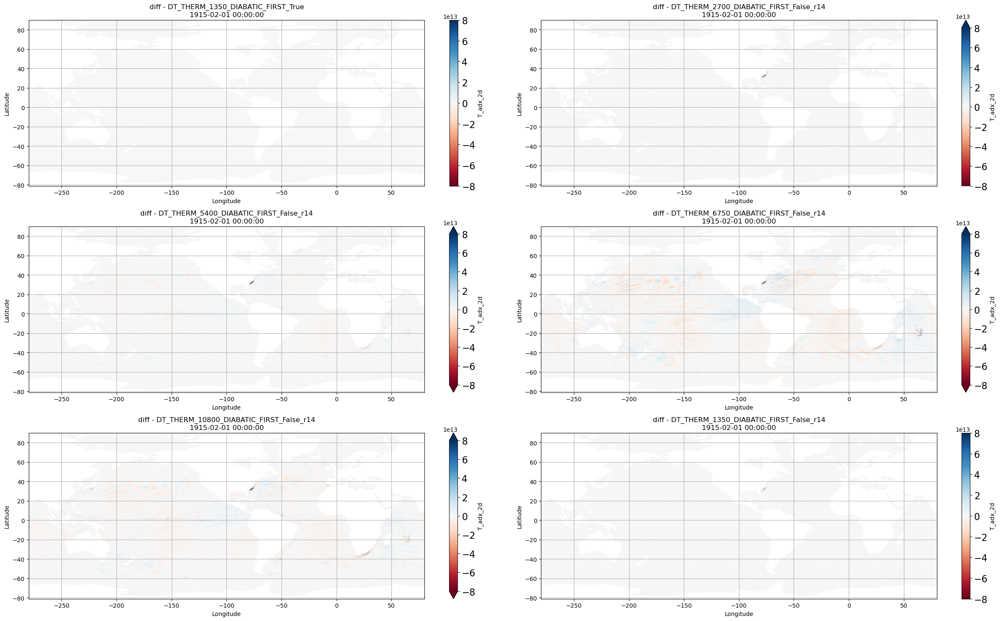

In [19]:
var = 'T_adx_2d'
common_time = pd.Timestamp('1915-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4,5]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-8e13,8e13])

0
1
2
3
4
5


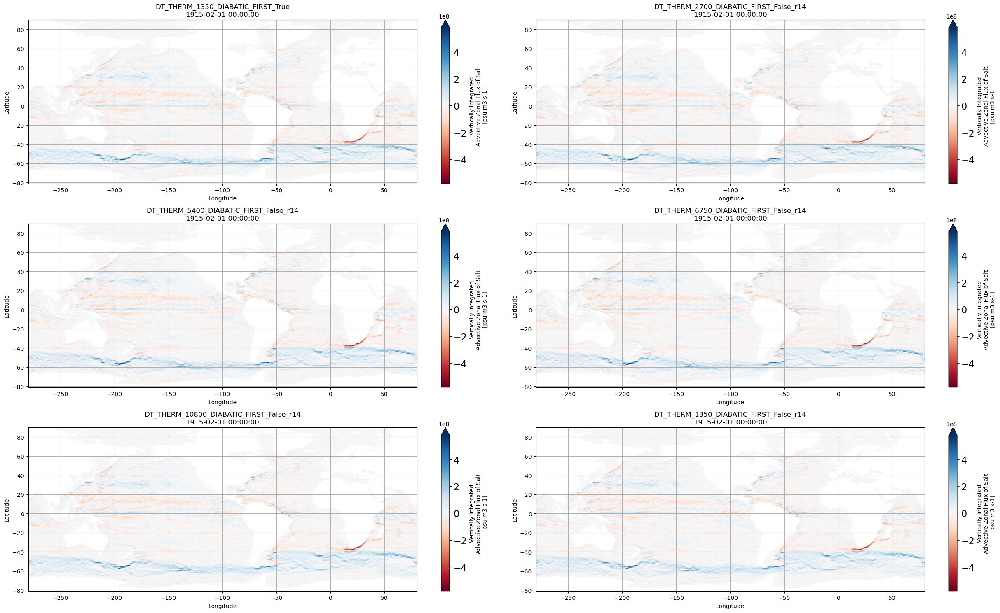

In [20]:
var = 'S_adx_2d'
common_time = pd.Timestamp('1915-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4,5]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-5.8e8,5.8e8])

0
1
2
3
4
5


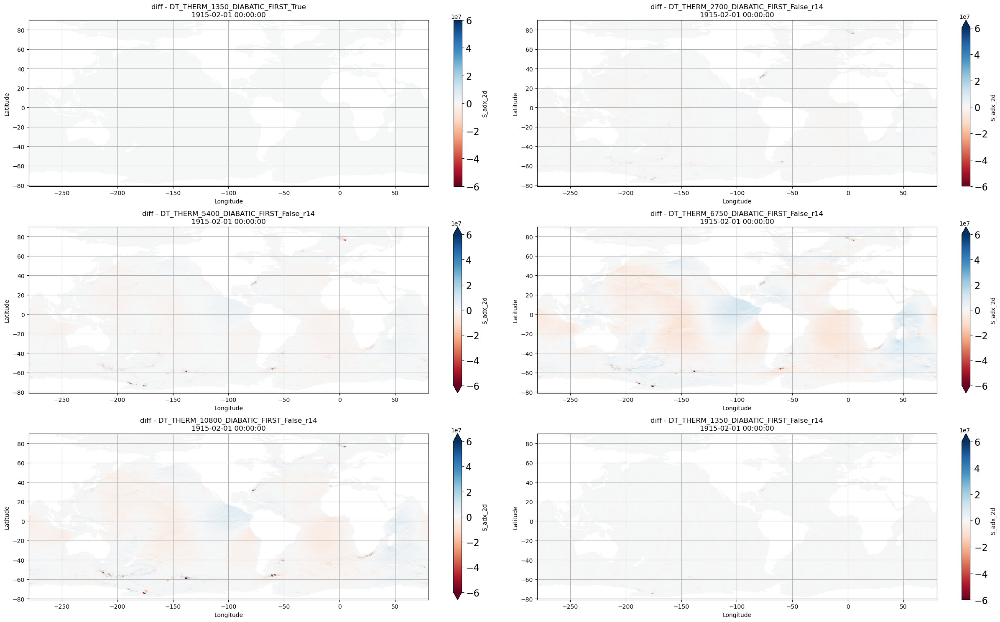

In [21]:
var = 'S_adx_2d'
common_time = pd.Timestamp('1915-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4,5]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-6e7,6e7])

0
1
2
3
4


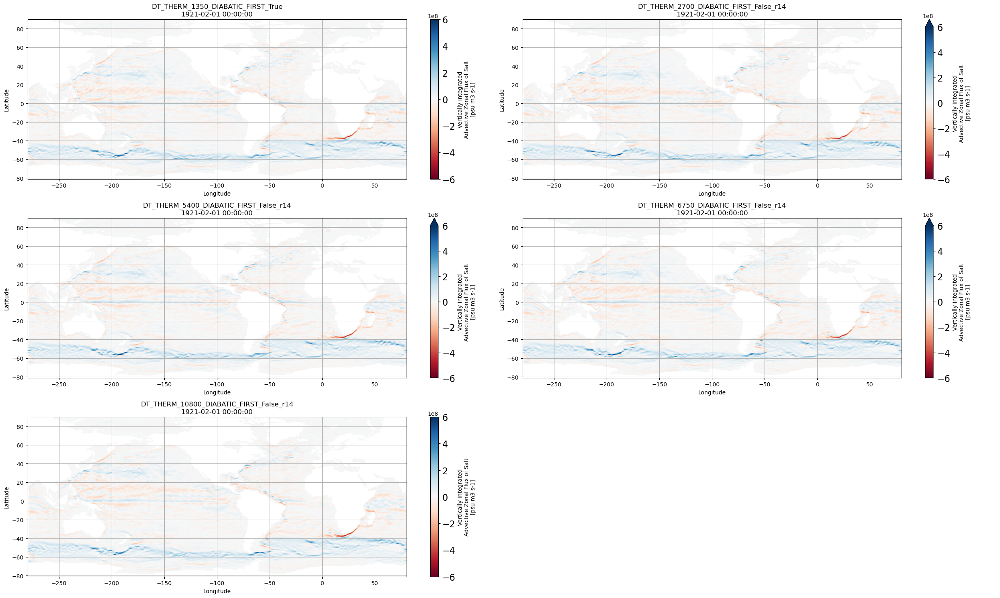

In [22]:
var = 'S_adx_2d'
common_time = pd.Timestamp('1921-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-6e8,6e8])

0
1
2
3
4


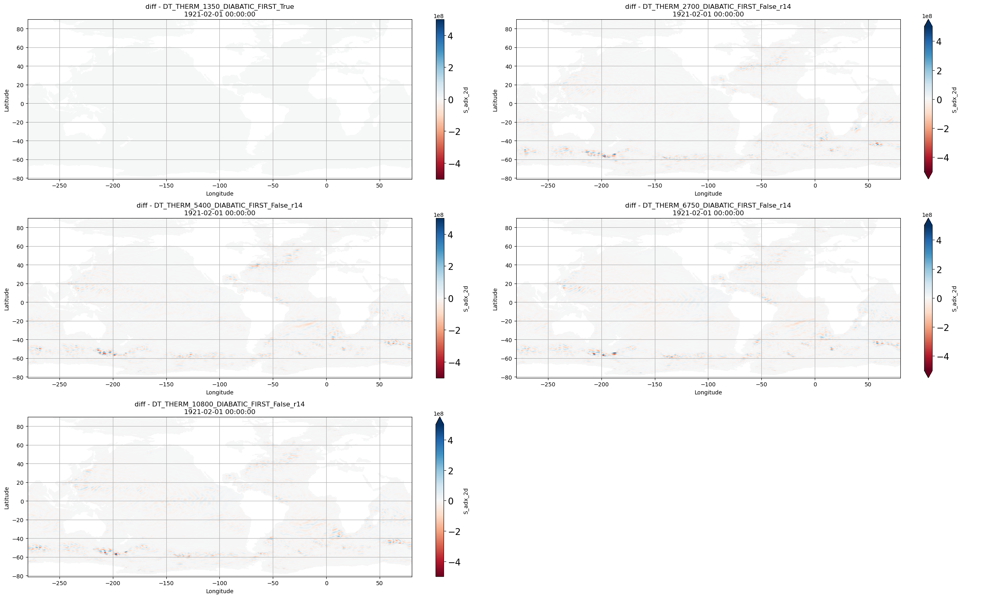

In [23]:
var = 'S_adx_2d'
common_time = pd.Timestamp('1921-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-5e8,5e8])

0
1
2
3
4


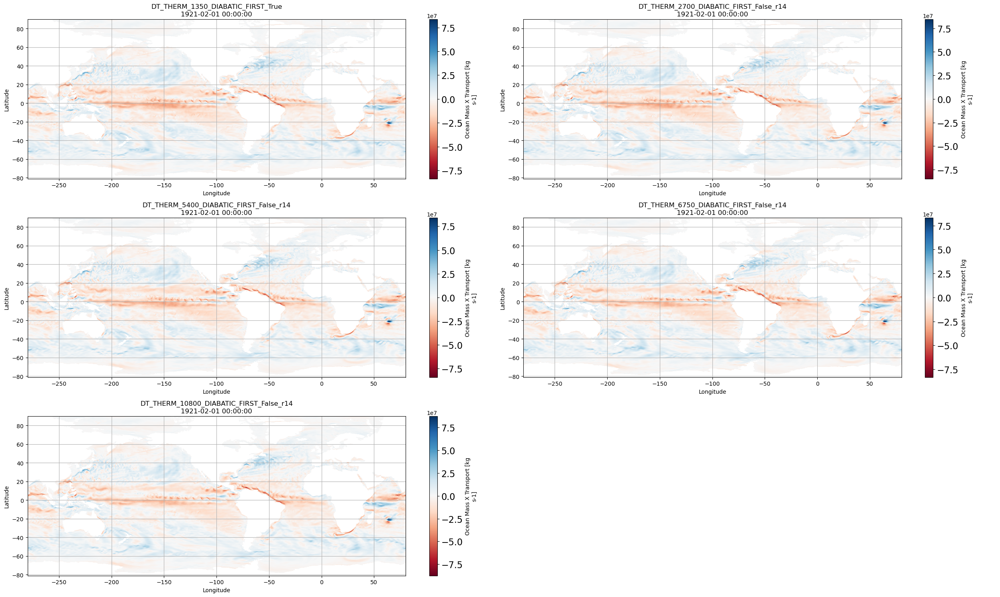

In [29]:
var = 'umo'
common_time = pd.Timestamp('1921-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        depth_level = 0,
        common_time = common_time,ncols=2,figsize=(25,15))

0
1
2
3
4


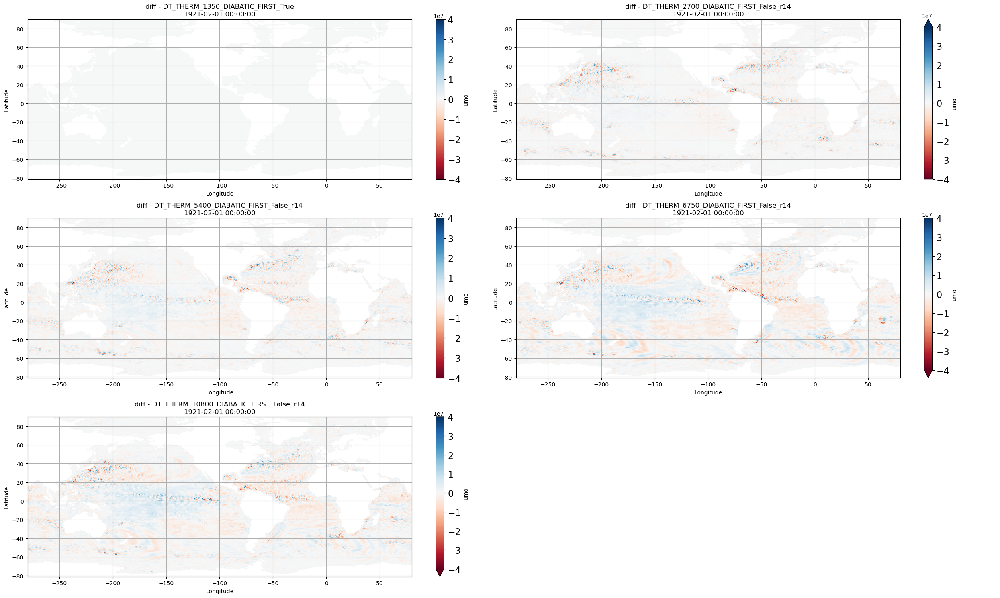

In [28]:
var = 'umo'
common_time = pd.Timestamp('1921-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = 0,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-4e7,4e7])

0
1
2
3
4


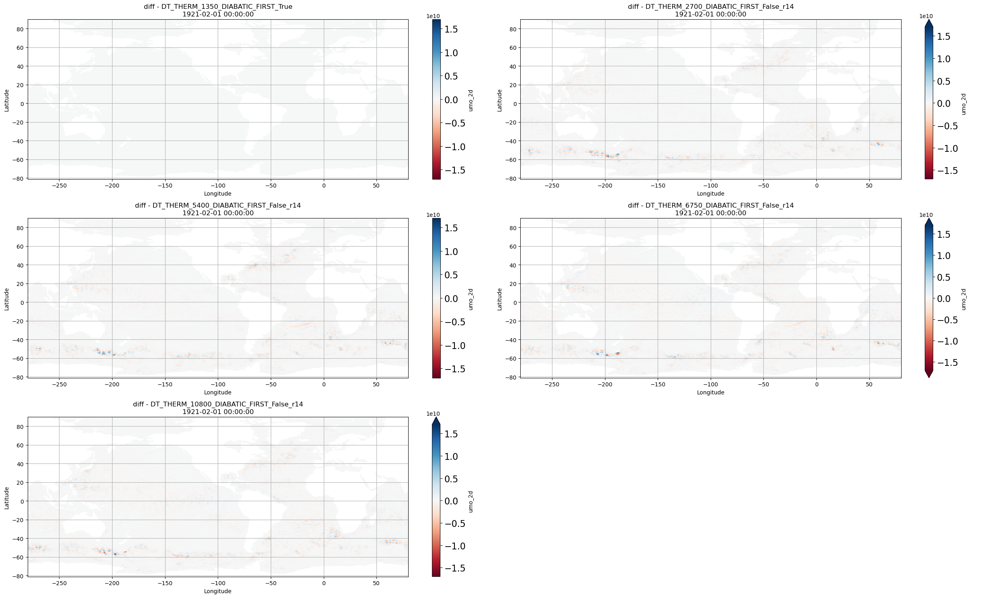

In [25]:
var = 'umo_2d'
common_time = pd.Timestamp('1921-02-01 00:00:00')
common_time = cftime.DatetimeNoLeap(common_time.year, common_time.month, common_time.day, 
                                    common_time.hour, common_time.minute, common_time.second)
tmp_indx = [0,1,2,3,4]
datastore_expts = [datastore_tot[i] for i in tmp_indx]
MOM_names_expts = [MOM_names_tot[i] for i in tmp_indx]
plot2d(datastore_expts,
        MOM_names_expts,
        var,
        datastore_ctrl = datastore_expts[0],
        depth_level = None,
        common_time = common_time,ncols=2,figsize=(25,15),
        cbar_range=[-1.7e10,1.7e10])

In [30]:
straits = {'Drake Passage': [ -69.9,  -69.9, -71.6, -51.0],
           'Lombok':        [-244.6, -243.9,  -8.6,  -8.6],
           'Ombai' :        [-235.0, -235.0,  -9.2,  -8.1],
           'Timor' :        [-235.9, -235.9, -11.9,  -9.9],
           'Denmark' :      [ -42.0,  -22.0,  65.8,  65.8],
           'Bering' :       [-172.0, -167.0,  65.8,  65.8],
           }

In [31]:
from pint import application_registry as ureg

In [ ]:
ρ0 = 1036 * ureg.kilogram / ureg.meter**3 # reference density

def calc_transport(experiment, strait, start_time='1900-1-1', end_time='1905-1-1'):
    """
    Calculate barotropic transport across a given 
    line of latitude or longitude.
     
    Designed for flow through straits.
    """

    xmin, xmax, ymin, ymax = straits[strait]

    if ymax >= 65:
        logging.warning('North of 65N the tripolar grid geometry brings complications and .sum(\'longitude\') is wrong!')

    print('Calculating {}: {} transport'.format(experiment, strait))

    if xmin == xmax:                
        ds = catalog[experiment].search(variable='tx_trans').to_dask()
        tx_trans = ds['tx_trans'].sel(time=slice(start_time, end_time))
        tx_trans = tx_trans.pint.quantify()

        transport = (tx_trans / ρ0).sel(time=slice(start_time, end_time))\
                                   .cf.sel(longitude=xmin, method='nearest')\
                                   .cf.sel(latitude=slice(ymin, ymax))\
                                   .cf.sum({'vertical', 'latitude'})
        transport.attrs['long_name'] = 'zonal transport'
    elif ymin == ymax:
        ds = catalog[experiment].search(variable='ty_trans').to_dask()
        ty_trans = ds['ty_trans'].sel(time=slice(start_time, end_time))
        ty_trans = ty_trans.pint.quantify()
        
        transport = (ty_trans / ρ0).sel(time=slice(start_time, end_time))\
                                   .cf.sel(longitude=slice(xmin, xmax))\
                                   .cf.sel(latitude=ymin, method='nearest')\
                                   .cf.sum({'vertical', 'longitude'})
        transport.attrs['long_name'] = 'meridional transport'
    else:
        raise ValueError('Transports are computed only along lines of either constant latitude or constant longitude')

    transport = transport.pint.to('sverdrup')
    transport = transport.compute()

    return transport